In [1]:
import scanpy as sc
import pandas as pd
from pathlib import Path
import anndata as ad
import numpy as np
import os
import scvi

%config InlineBackend.figure_format = 'retina'
%matplotlib inline

import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns

DPI = 300
FONTSIZE = 20  # 42

sc.settings.set_figure_params(
    scanpy=True, dpi=100, transparent=True, vector_friendly=True, dpi_save=DPI
)
from matplotlib import rcParams

rcParams["pdf.fonttype"] = 42

Global seed set to 0


In [2]:
DIR2SAVE = Path(
    "/data/BCI-CRC/nasrine/data/CRC/Metastatic_CRC_LM_dataset/subpopulations/Stromal"
)
DIR2SAVE.mkdir(parents=True, exist_ok=True)

In [3]:
FIG2SAVE = DIR2SAVE.joinpath("figures/")
FIG2SAVE.mkdir(parents=True, exist_ok=True)
# set the global variable: sc.settings.figdir to save all plots
sc.settings.figdir = FIG2SAVE

In [4]:
adata = sc.read_h5ad(
    DIR2SAVE.joinpath("Multiome_Che_Wu_CRC_LM_integrated_scvi_hvg_Stromal.h5ad")
)

In [5]:
adata

AnnData object with n_obs × n_vars = 1002 × 2000
    obs: 'Patient', 'Sample', 'Cell_type', 'Cell_subtype', 'Tissue', 'Therapy', 'doublet_score', 'n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_ribo', 'cell_source', 'Annotation_scVI', 'S_score', 'G2M_score', 'phase', 'cell_cycle_diff', '_scvi_batch', '_scvi_labels'
    var: 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'Cell_subtype_colors', 'Cell_type_colors', 'Therapy_colors', 'Tissue_colors', '_scvi_manager_uuid', '_scvi_uuid', 'cell_source_colors', 'hvg', 'log1p', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_scVI', 'X_umap', '_scvi_extra_categorical_covs', '_scvi_extra_continuous_covs'
    varm: 'PCs'
    layers: 'log1p', 'normalised', 'raw', 'scvi_normalized'
    obsp: 'connectivities', 'distances'

In [6]:
adata.obs.cell_source.value_counts()

BCI-Nuclei    668
Che-Cells     334
Name: cell_source, dtype: int64

### Leiden clustering

In [7]:
adata.uns["neighbors"]

OverloadedDict, wrapping:
	{'connectivities_key': 'connectivities', 'distances_key': 'distances', 'params': {'method': 'umap', 'metric': 'euclidean', 'n_neighbors': 5, 'n_pcs': 15, 'random_state': 7, 'use_rep': 'X_scVI'}}
With overloaded keys:
	['connectivities', 'distances'].

In [8]:
from collections import Counter


def clustering_leiden_resolution(adata2test, res_range):
    """
    Performs hyperparameter search for resolution in leiden clustering
    :param adata2test: AnnData frame
    :param res_range: range of values to evaluate: i.e. np.arange(0.1, 1.5, 0.05)
    """
    resolution_dict = {r: None for r in res_range}
    # vary resolution parameter and see which nb of clusters occurs more frequently
    for r in res_range:
        # load adata
        adata = adata2test.copy()
        sc.tl.leiden(adata, resolution=r, random_state=7)
        # store nb of clusters for that resolution
        resolution_dict[r] = len(set(adata.obs["leiden"]))

    # plot figure: nb clusters in fct of resolution param
    fig, ax = plt.subplots(
        nrows=1, ncols=1, sharey=False, sharex=False, dpi=DPI, figsize=(5, 4.5)
    )
    plt.scatter(resolution_dict.keys(), resolution_dict.values())
    ax.set_xlabel("Resolution")
    ax.set_ylabel("Number of clusters")
    ax.tick_params(axis="both", which="major", labelsize=FONTSIZE - 10)
    plt.show()

    # display nb of times each number of clusters occurs
    print("Frequency of NB clusters")
    print(Counter(list(resolution_dict.values())))

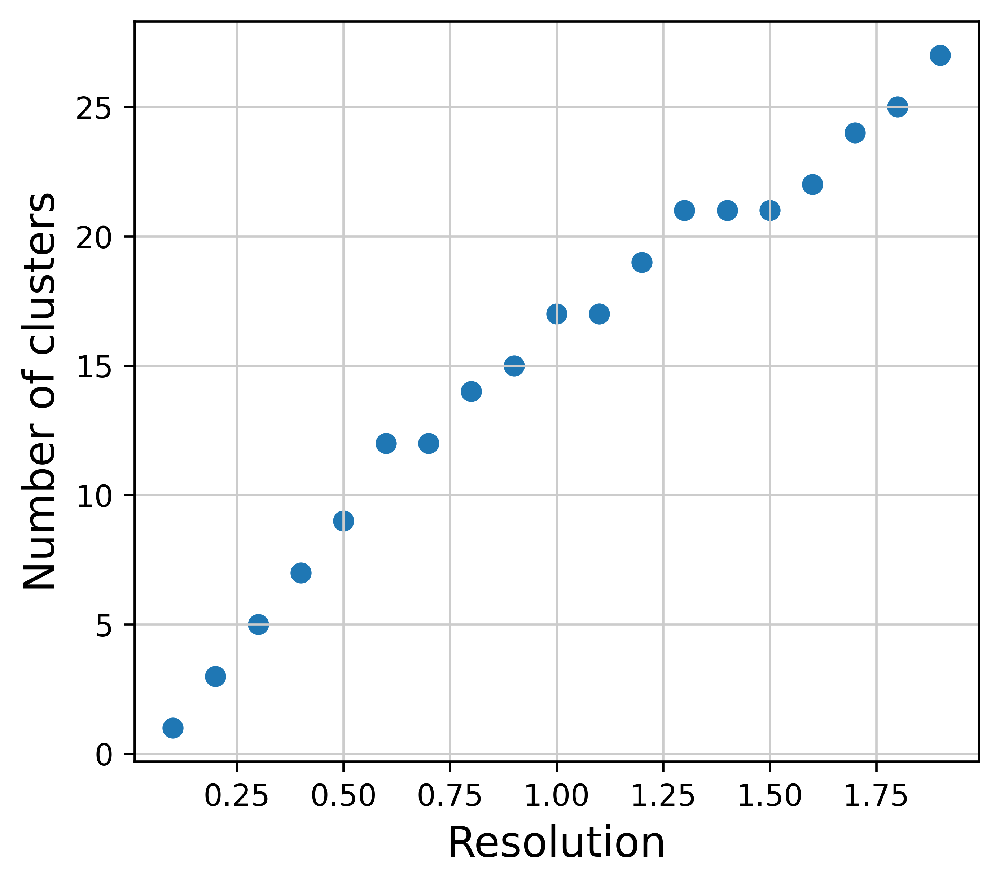

Frequency of NB clusters
Counter({21: 3, 12: 2, 17: 2, 1: 1, 3: 1, 5: 1, 7: 1, 9: 1, 14: 1, 15: 1, 19: 1, 22: 1, 24: 1, 25: 1, 27: 1})


In [9]:
clustering_leiden_resolution(adata, res_range=np.arange(0.1, 2, 0.1))

In [10]:
# neighbors were already computed using Harmony corrected PCs, so we perform clustering on that graph
sc.tl.leiden(adata, key_added="leiden_scVI", resolution=0.7, random_state=7)

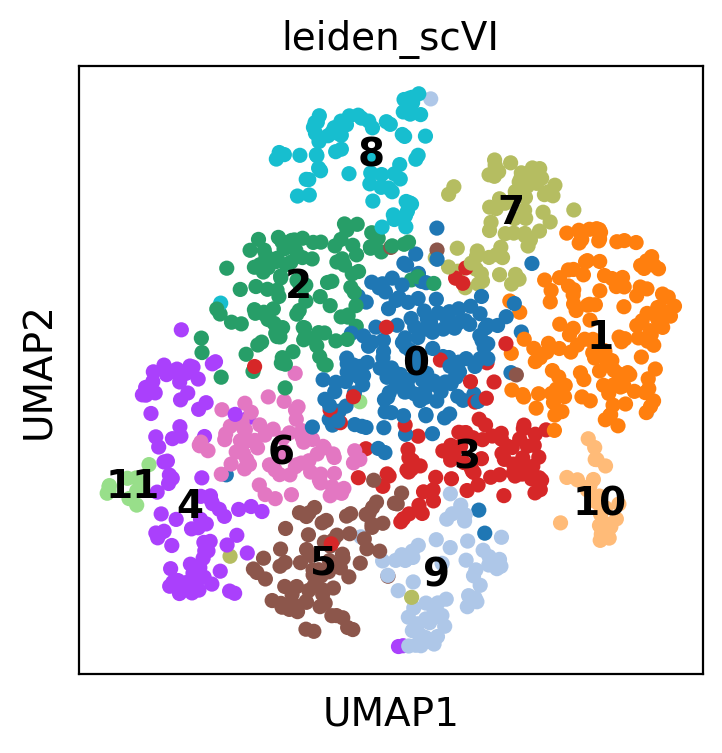

In [11]:
sc.pl.umap(
    adata,
    color="leiden_scVI",
    legend_loc="on data",
    save="general_clustering.pdf",
    show=True,
)

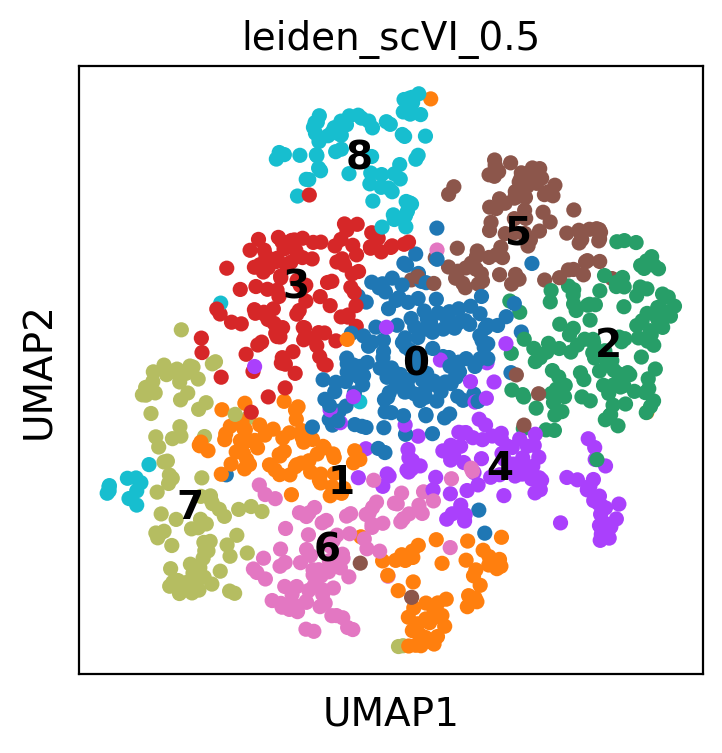

In [12]:
# neighbors were already computed using Harmony corrected PCs, so we perform clustering on that graph
sc.tl.leiden(adata, key_added="leiden_scVI_0.5", resolution=0.5, random_state=7)
sc.pl.umap(adata, color="leiden_scVI_0.5", legend_loc="on data", show=True)

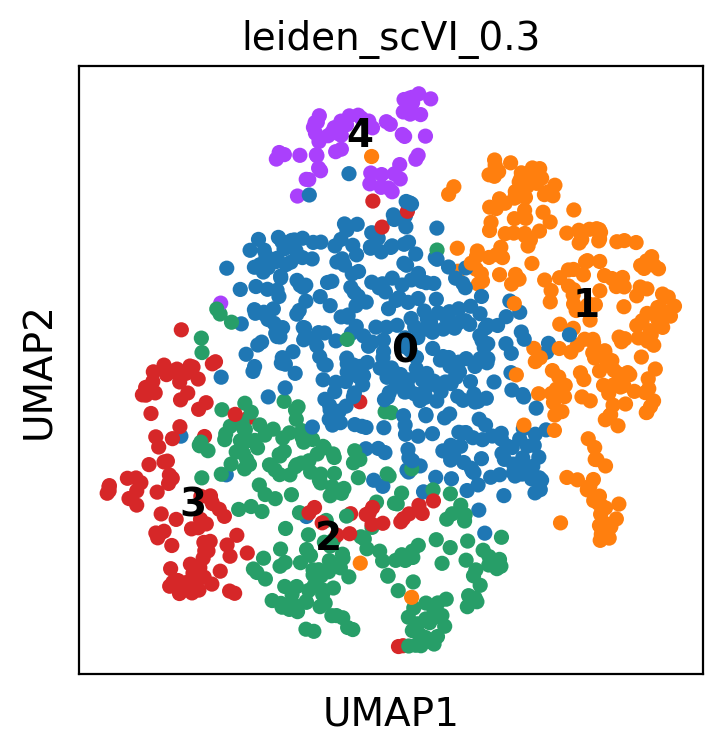

In [13]:
# neighbors were already computed using Harmony corrected PCs, so we perform clustering on that graph
sc.tl.leiden(adata, key_added="leiden_scVI_0.3", resolution=0.3, random_state=7)
sc.pl.umap(adata, color="leiden_scVI_0.3", legend_loc="on data", show=True)

In [14]:
adata.obs.Patient.value_counts()

COL15    142
CRC10    132
CRC08    108
COL18     92
CRC12     75
CRC02     69
CRC06     57
COL17     56
CRC09     50
CRC15     40
CRC03     37
CRC11     35
CRC14     23
COL12     20
CRC04     17
COL16     16
CRC13     14
CRC05     11
COL07      8
Name: Patient, dtype: int64

In [15]:
adata.obs.leiden_scVI.value_counts()

0     162
1     143
2     114
3      91
4      89
5      80
6      74
7      71
8      71
9      65
10     30
11     12
Name: leiden_scVI, dtype: int64

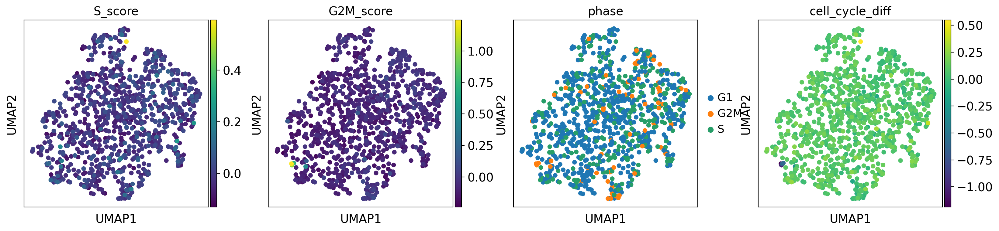

In [16]:
sc.pl.umap(
    adata,
    color=["S_score", "G2M_score", "phase", "cell_cycle_diff"],
    color_map="viridis",
    save="cell_cycle.pdf",
)

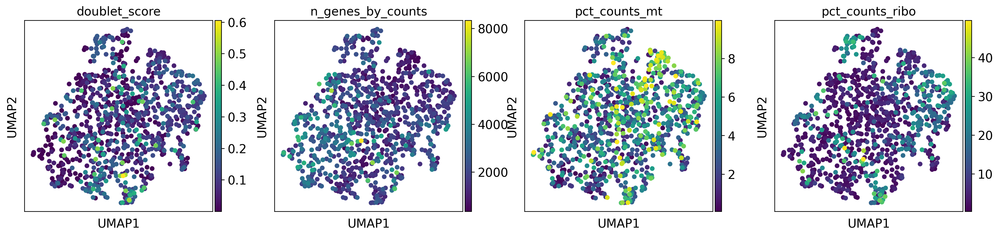

In [17]:
sc.pl.umap(
    adata,
    color=["doublet_score", "n_genes_by_counts", "pct_counts_mt", "pct_counts_ribo"],
    color_map="viridis",
    save="QC_covariates.pdf",
)

### Plot some markers 

In [18]:
markers = {
    "Enteric glial": ["S100B", "PLP1"],
    "Pericyte": ["PDGFRB", "RGS5", "TAGLN", "ACTA2", "ABCC9"],
    "SMC": ["TAGLN", "ACTA2", "MYH11", "DES"],  # smooth muscle cell
    "Myofibro": ["TAGLN", "ACTA2", "COL1A1"],
    "Fibro": ["COL3A1", "DCN", "THY1", "SRPX", "C7"],
    "CAF": ["FAP", "PDPN"],
    "Inflammatory": ["IL6", "IL11", "PDGFRA"],
    "Immune-regulatory": ["CXCL12", "CXCL14"],
    "C3 CD34 immunomodulatory": [
        "C3",
        "CD34",
        "SFRP1",
        "SFRP2",
        "CXCL12",
        "FBLN5",
        "RSPO3",
    ],
    "CXCL14 BMP": [
        "CXCL14",
        "BMP4",
        "BMP5",
        "WNT4",
        "BMP7",
        "PDGFRA",
        "C2",
        "CSF1",
        "TGFBR2",
    ],
    "GREM1": ["GREM1", "SFRP4", "VCAN"],
    "MMP": [
        "MMP3",
        "MMP1",
        "CXCL5",
        "CXCL13",
        "CXCL6",
        "MMP9",
        "MMP13",
        "CXCL1",
        "CXCL8",
        "COL7A1",
        "BAMBI",
        "IL6",
        "IL11",
        "TGFBR1",
    ],
    "CCL8": ["CCL8", "TGFB1", "IL34", "C2", "CCL13", "CXCL14", "APOE", "CCL2"],
    "HSC": ["ACTA2", "COL1A1", "TAGLN", "COL1A2", "COL3A1", "SPARC", "CLEC4G"],
}

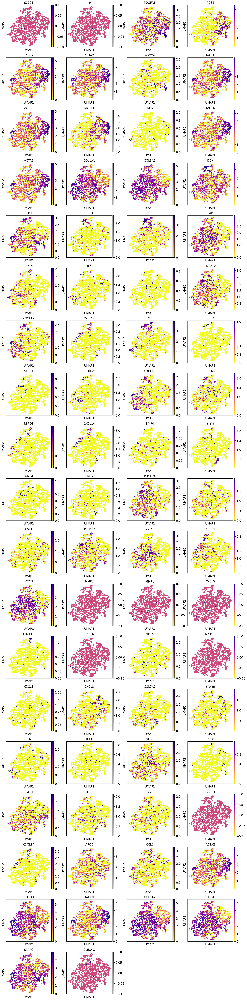

In [19]:
import itertools

# use log1p data stored in .raw
markers2plot = list(
    itertools.chain(*list(markers.values()))
)  # get all markers in a single list
sc.pl.umap(
    adata,
    color=markers2plot,
    use_raw=True,
    vmin=0.0,
    vmax="p99",
    color_map="plasma_r",  #'RdPu',
    save="general_markers.pdf",
    show=True,
)

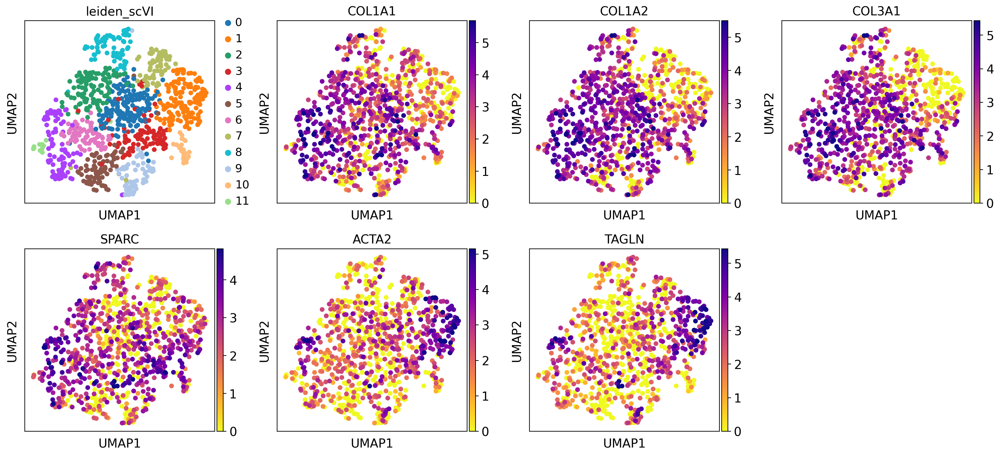

In [20]:
sc.pl.umap(
    adata,
    color=["leiden_scVI", "COL1A1", "COL1A2", "COL3A1", "SPARC", "ACTA2", "TAGLN"],
    use_raw=True,
    vmin=0.0,
    vmax="p99",
    color_map="plasma_r",
    show=True,
)

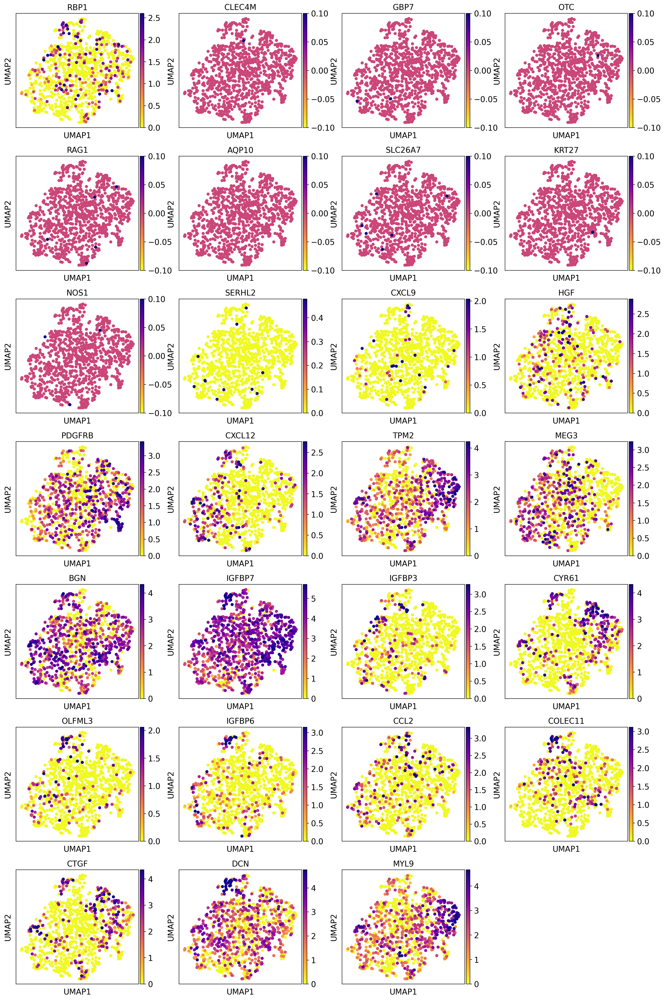

In [21]:
# genes reported to be highly expressed in hepatic stellate cells (from protein atlas)
# https://www.proteinatlas.org/search/cell_type_category_rna%3AHepatic+stellate+cells%3BCell+type+enriched%2CGroup+enriched%2CCell+type+enhanced+AND+sort_by%3Atissue+specific+score
hsc_prot = [
    "RBP1",
    "CLEC4M",
    "GBP7",
    "OTC",
    "RAG1",
    "AQP10",
    "SLC26A7",
    "KRT27",
    "NOS1",
    "SERHL2",
    "CXCL9",
    "HGF",
    "PDGFRB",
    "CXCL12",
    "TPM2",
    "MEG3",
    "BGN",
    "IGFBP7",
    "IGFBP3",
    "CYR61",
    "OLFML3",
    "IGFBP6",
    "CCL2",
    "COLEC11",
    "CTGF",
    "DCN",
    "MYL9",
]
sc.pl.umap(
    adata,
    color=hsc_prot,
    use_raw=True,
    vmin=0.0,
    vmax="p99",
    color_map="plasma_r",
    show=True,
)

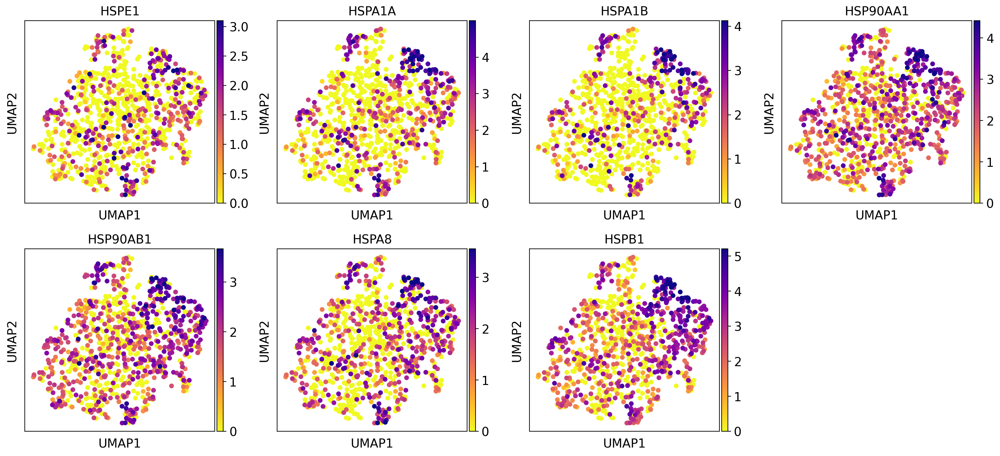

In [22]:
### markers for stress
# HSP
dissocation_markers_dict = {
    "shock protein": [
        "HSPE1",
        "HSPA1A",
        "HSPA1B",
        "HSP90AA1",
        "HSP90AB1",
        "HSPA8",
        "HSPB1",
    ],
    "immediate early genes": ["FOS", "JUN"],
}

sc.pl.umap(
    adata,
    color=dissocation_markers_dict["shock protein"],
    vmax="p99",
    use_raw=True,
    vmin=0,
    color_map="plasma_r",
    save="general_HSPmarkers.pdf",
    show=True,
)

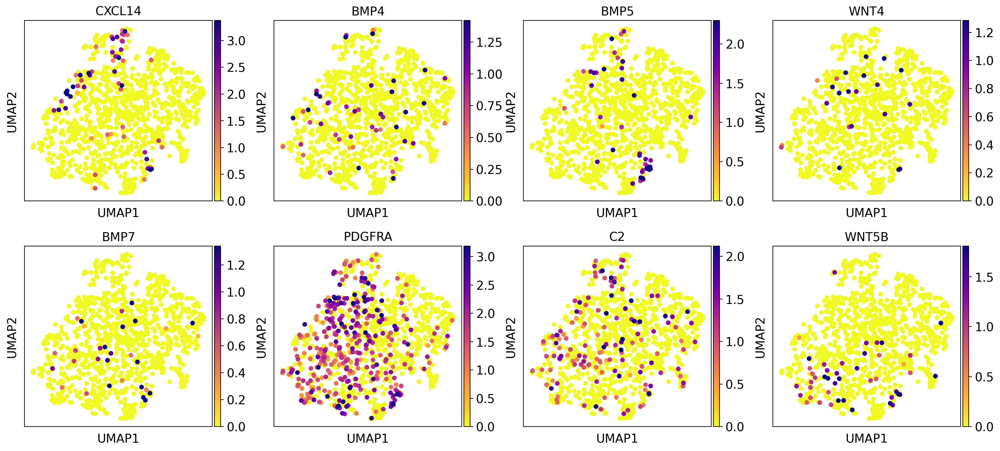

In [38]:
# use log1p data stored in .raw
markers2plot = ["CXCL14", "BMP4", "BMP5", "WNT4", "BMP7", "PDGFRA", "C2", "WNT5B"]
sc.pl.umap(
    adata,
    color=markers2plot,
    use_raw=True,
    vmin=0.0,
    vmax="p99",
    color_map="plasma_r",  #'RdPu',
    save="BMP_markers.pdf",
    show=True,
)

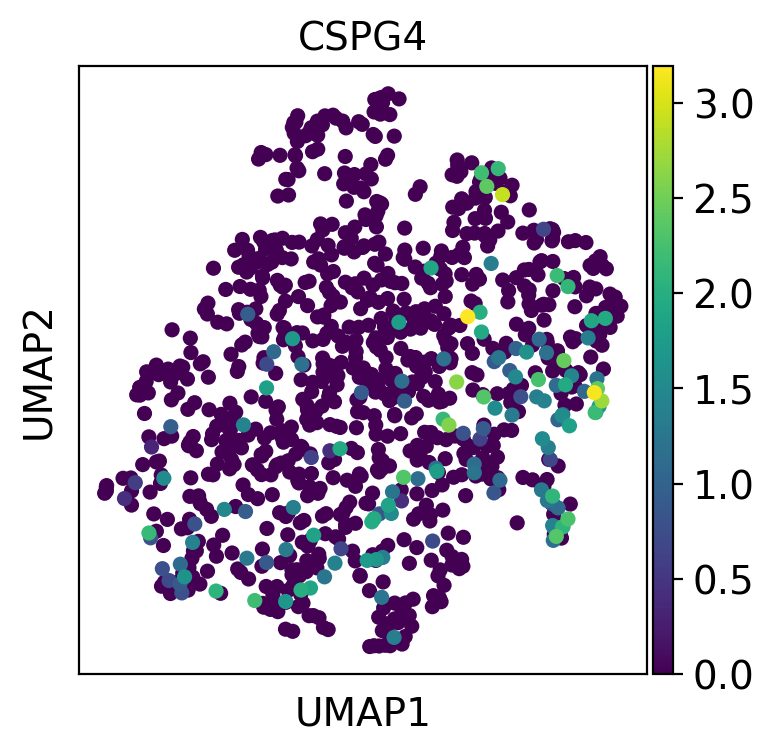

In [5]:
sc.pl.umap(adata, color="CSPG4")

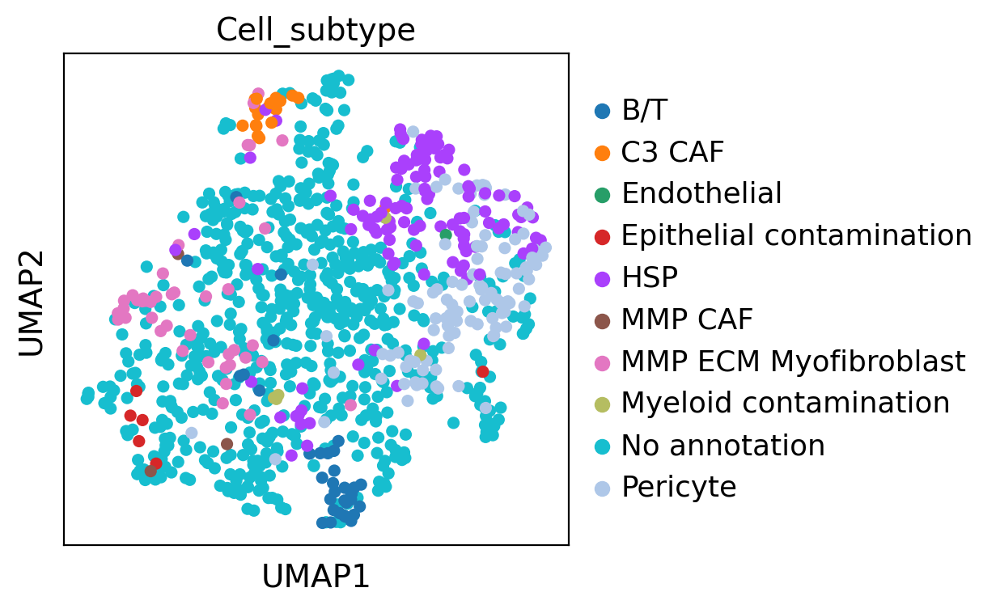

In [23]:
sc.pl.umap(adata, color="Cell_subtype")

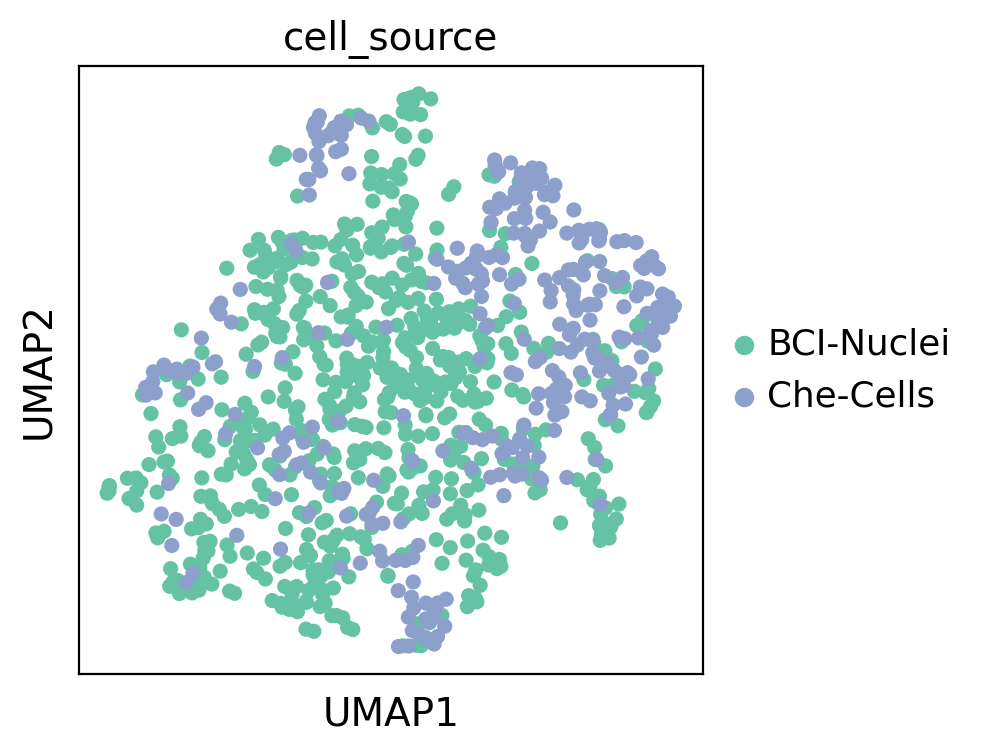

In [24]:
sc.pl.umap(adata, color="cell_source")

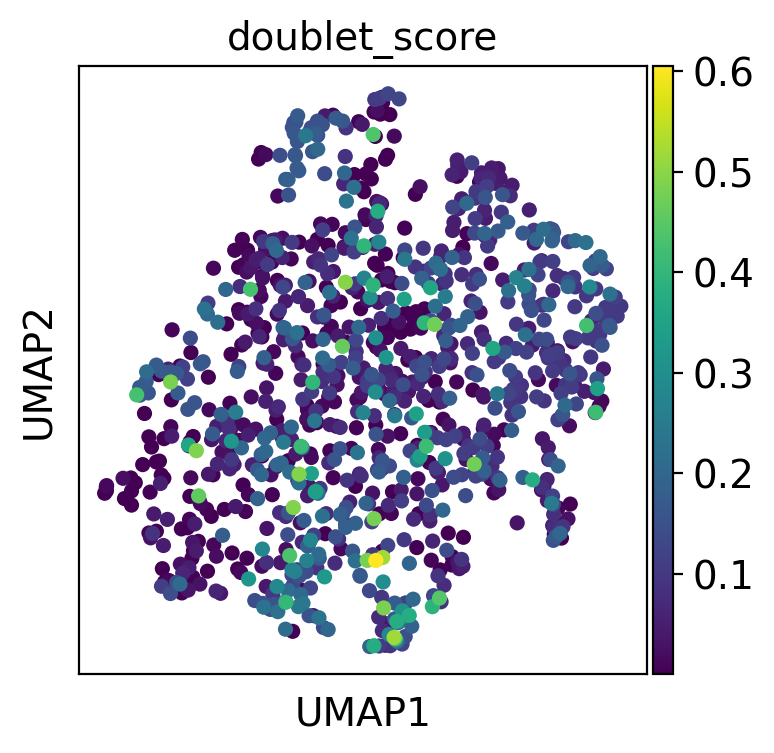

In [39]:
sc.pl.umap(adata, color="doublet_score")

In [25]:
adata.obs.groupby(["leiden_scVI", "cell_source"]).size()

leiden_scVI  cell_source
0            BCI-Nuclei     151
             Che-Cells       11
1            BCI-Nuclei      33
             Che-Cells      110
2            BCI-Nuclei     101
             Che-Cells       13
3            BCI-Nuclei      61
             Che-Cells       30
4            BCI-Nuclei      63
             Che-Cells       26
5            BCI-Nuclei      67
             Che-Cells       13
6            BCI-Nuclei      57
             Che-Cells       17
7            BCI-Nuclei      12
             Che-Cells       59
8            BCI-Nuclei      44
             Che-Cells       27
9            BCI-Nuclei      40
             Che-Cells       25
10           BCI-Nuclei      27
             Che-Cells        3
11           BCI-Nuclei      12
             Che-Cells        0
dtype: int64

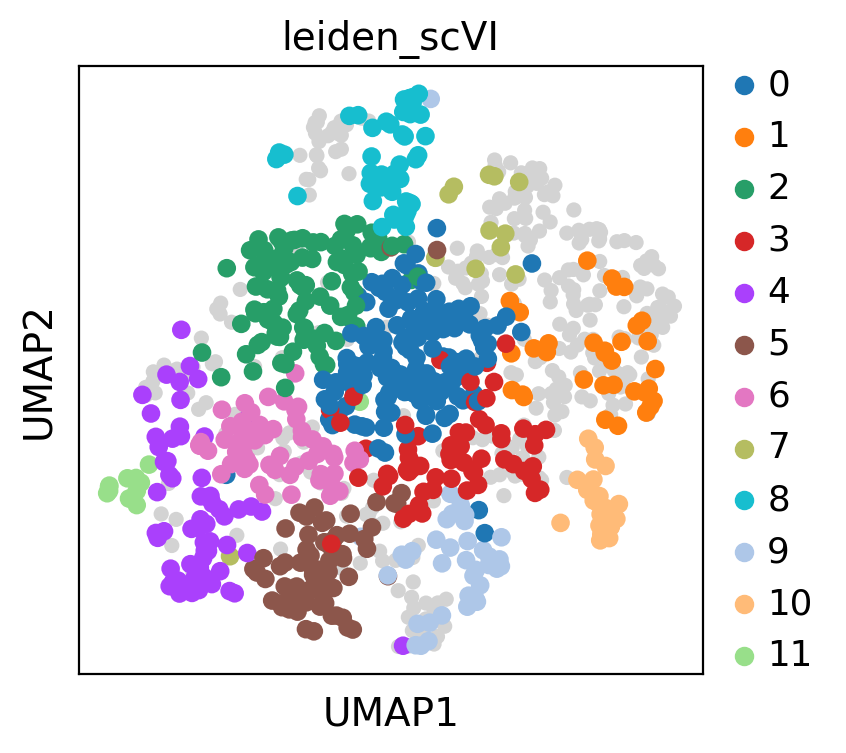

In [26]:
ax = sc.pl.umap(adata, show=False)
sc.pl.umap(
    adata[adata.obs["cell_source"] == "BCI-Nuclei"],
    color="leiden_scVI",
    color_map="viridis",
    ax=ax,
)

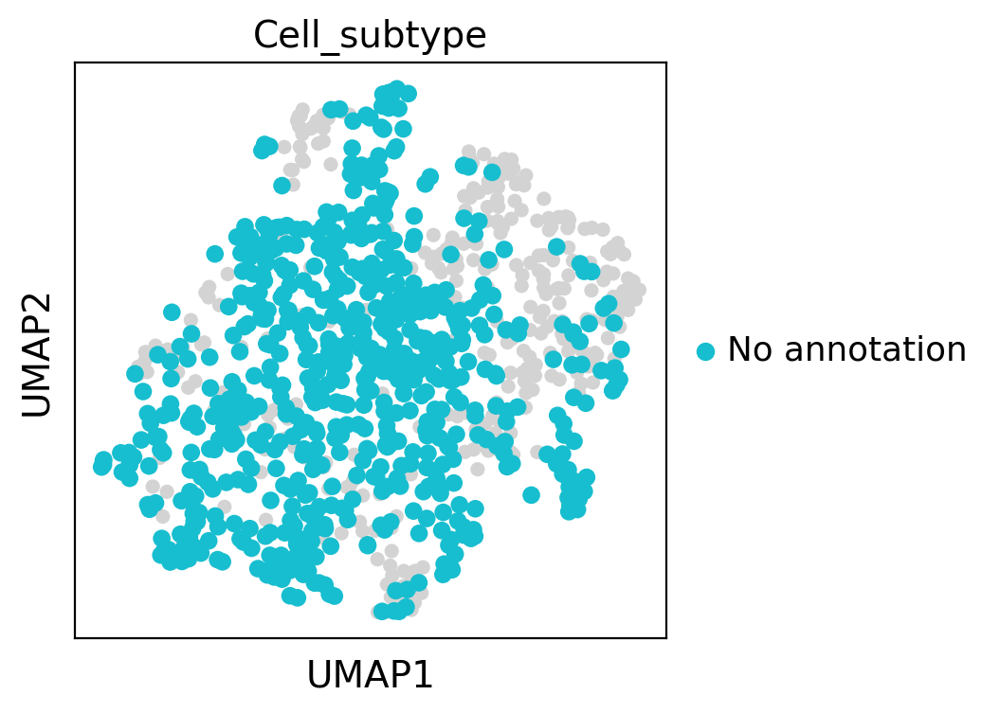

In [27]:
ax = sc.pl.umap(adata, show=False)
sc.pl.umap(
    adata[adata.obs["cell_source"] == "BCI-Nuclei"],
    color="Cell_subtype",
    color_map="viridis",
    ax=ax,
)

### Differential expression to get DE genes upregulated per cluster 

In [28]:
# issue here https://github.com/theislab/single-cell-tutorial/issues/97
# This seems to be a scanpy bug as you can see here and here. The latter issue suggests to just add the line:
# adata.uns['log1p']["base"] = None after reading again, or downgrading to AnnData<0.8.
# Either way, this should be fixed soon by the maintenance team.
adata.uns["log1p"]["base"] = None

In [29]:
sc.tl.rank_genes_groups(
    adata,
    groupby="leiden_scVI",
    reference="rest",
    method="wilcoxon",
    use_raw=True,
    layer=None,
    pts=True,
    corr_method="benjamini-hochberg",
    key_added="rank_genes_wilcoxon",
)

categories: 0, 1, 2, etc.
var_group_labels: Enteric glial, Pericyte, SMC, etc.


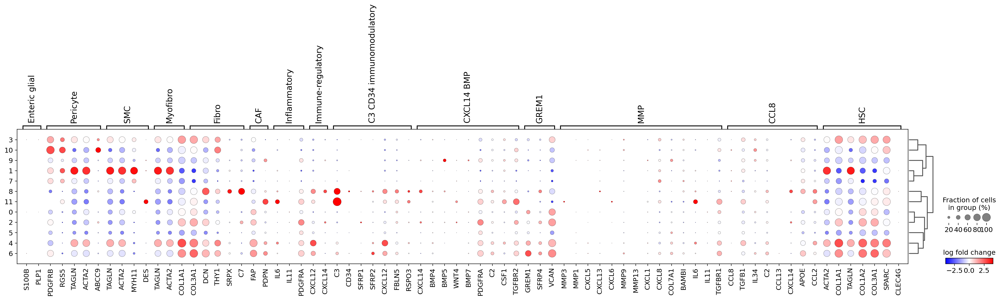

In [30]:
sc.pl.rank_genes_groups_dotplot(
    adata,
    groupby="leiden_scVI",
    key="rank_genes_wilcoxon",
    var_names=markers,
    values_to_plot="logfoldchanges",
    cmap="bwr",
    vmin=-4,
    vmax=4,
    min_logfoldchange=1,
    colorbar_title="log fold change",
    save="general_dotplot.pdf",
    show=True,
)

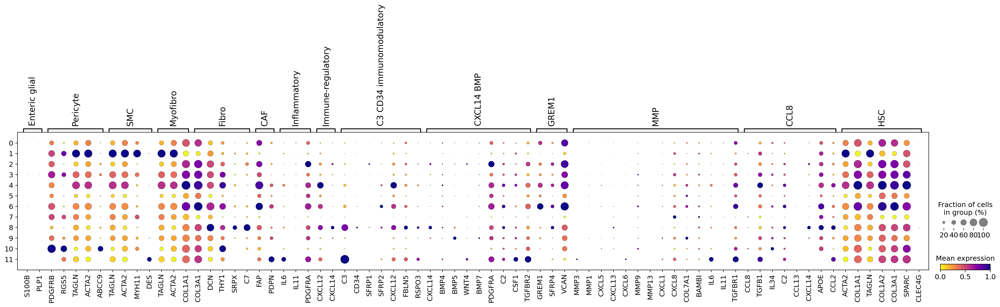

In [31]:
sc.pl.dotplot(
    adata,
    groupby="leiden_scVI",
    use_raw=True,
    var_names=markers,
    cmap="plasma_r",
    standard_scale="var",
    vmin=0,
    vmax=1,
    colorbar_title="Mean expression",
    dendrogram=False,
    save="dotplot_mean_general.pdf",
    show=True,
)

categories: 0, 1, 2, etc.
var_group_labels: shock protein, immediate early genes


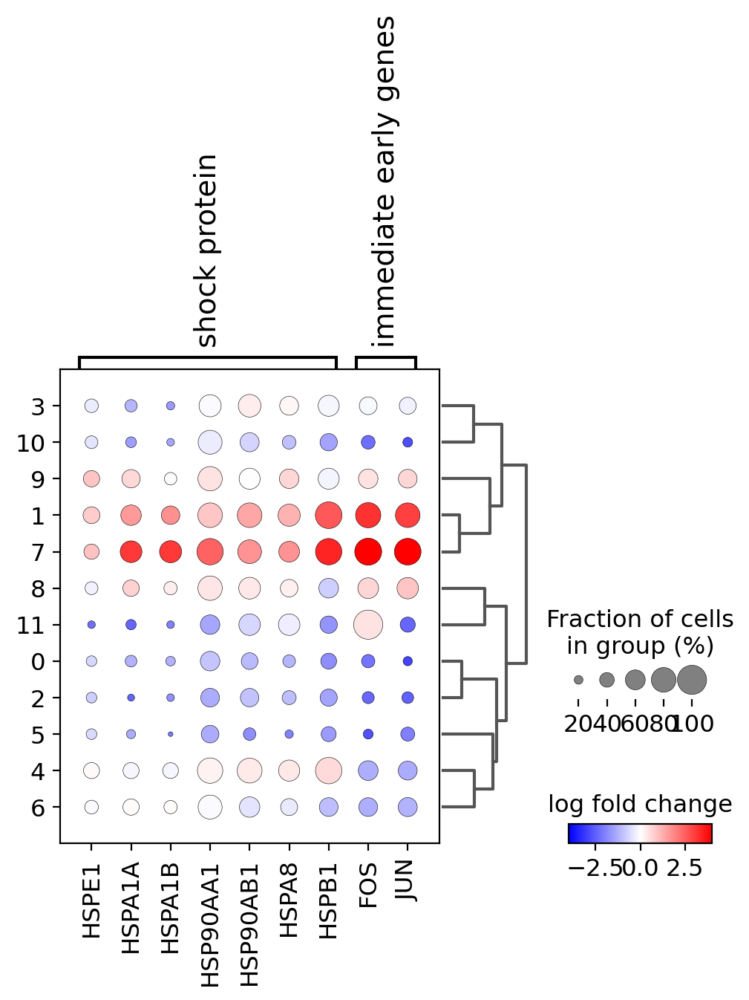

In [32]:
sc.pl.rank_genes_groups_dotplot(
    adata,
    groupby="leiden_scVI",
    key="rank_genes_wilcoxon",
    var_names=dissocation_markers_dict,
    values_to_plot="logfoldchanges",
    cmap="bwr",
    vmin=-4,
    vmax=4,
    min_logfoldchange=1,
    colorbar_title="log fold change",
    save="HSP_dotplot.pdf",
    show=True,
)

In [33]:
pval_thresh = 0.05
log2fc_thresh = 1
cluster_de_genes = dict()
for cluster in sorted(set(adata.obs["leiden_scVI"])):
    cluster_de_genes[cluster] = sc.get.rank_genes_groups_df(
        adata,
        group=cluster,
        key="rank_genes_wilcoxon",
        pval_cutoff=pval_thresh,
        log2fc_min=log2fc_thresh,
        log2fc_max=None,
    ).sort_values("logfoldchanges", ascending=False)

# write to excel file DE genes per cluster
# Create a Pandas Excel writer using XlsxWriter as the engine.
path2save = DIR2SAVE.joinpath(
    "Stromal_pval{}_log2fc{}.xlsx".format(pval_thresh, log2fc_thresh)
)

with pd.ExcelWriter(path2save) as writer:
    for cluster in list(cluster_de_genes.keys()):

        # get celltype of cluster
        # celltype = np.unique(adata[adata.obs['leiden']==cluster,:].obs['cell identity'])[0]

        cluster_de_genes[cluster].to_excel(
            writer, sheet_name="cluster{}".format(cluster)
        )

In [34]:
# save intermediate result
# write to file
adata.write(
    DIR2SAVE.joinpath(
        "Multiome_Che_Wu_CRC_LM_integrated_scvi_hvg_Stromal_clustering.h5ad"
    )
)

In [35]:
DIR2SAVE

PosixPath('/data/BCI-CRC/nasrine/data/CRC/Metastatic_CRC_LM_dataset/subpopulations/Stromal')

In [36]:
# from https://aacrjournals.org/cancerdiscovery/article/9/8/1102/42174/Cross-Species-Single-Cell-Analysis-of-Pancreatic
icaf_markers = ["IL6", "CXCL12", "CFD", "DPT", "LMNA", "CXCL2", "CCL2", "IL1R1"]
mycaf_markers = ["ACTA2", "TAGLN", "MMP11", "MYL9", "HOPX", "POSTN", "TPM1", "TPM2"]

8


/data/BCI-CRC/nasrine/anaconda/envs/cell2loc19/lib/python3.9/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


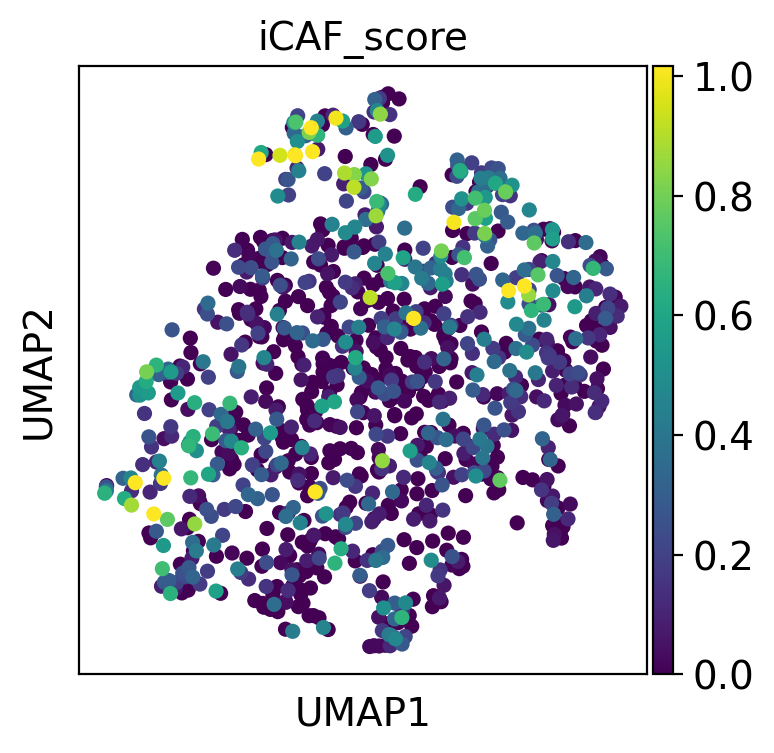

length of gene list in adata.var: 8
8


/data/BCI-CRC/nasrine/anaconda/envs/cell2loc19/lib/python3.9/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


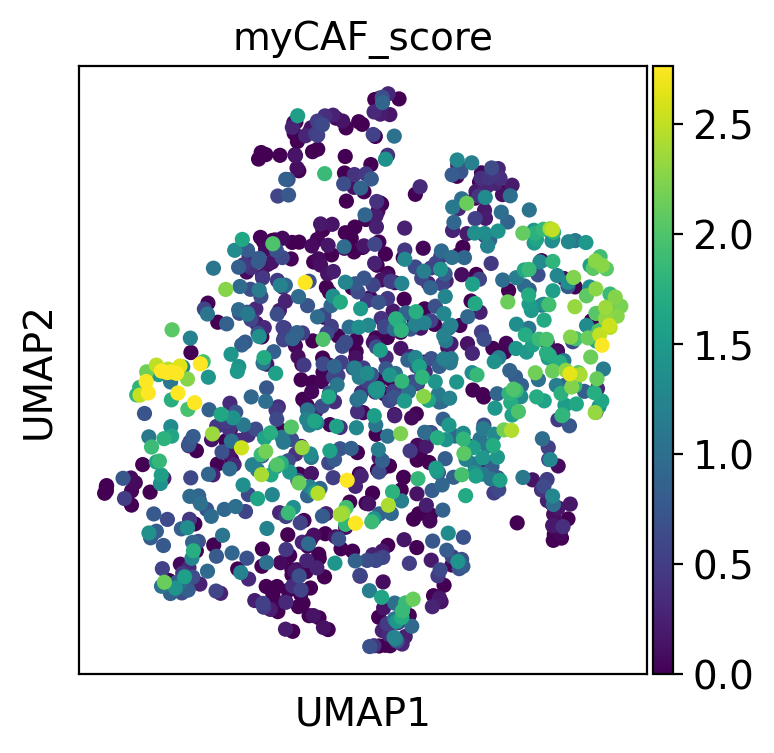

length of gene list in adata.var: 8


In [37]:
# score for iCAFs and myCAFs
print(len(icaf_markers))
icaf_markers_var = [
    gene for gene in icaf_markers if gene in adata.raw.to_adata().var_names
]
sc.tl.score_genes(
    adata, gene_list=icaf_markers_var, score_name="iCAF_score", use_raw=True
)
sc.pl.umap(
    adata,
    color="iCAF_score",
    vmax="p99",
    use_raw=True,
    vmin=0,
    save="iCAF_score.pdf",
    show=True,
    color_map="viridis",
)
print("length of gene list in adata.var:", len(icaf_markers_var))


print(len(mycaf_markers))
mycaf_markers_var = [
    gene for gene in mycaf_markers if gene in adata.raw.to_adata().var_names
]
sc.tl.score_genes(
    adata, gene_list=mycaf_markers_var, score_name="myCAF_score", use_raw=True
)
sc.pl.umap(
    adata,
    color="myCAF_score",
    vmax="p99",
    use_raw=True,
    vmin=0,
    save="myCAF_score.pdf",
    show=True,
    color_map="viridis",
)
print("length of gene list in adata.var:", len(mycaf_markers_var))

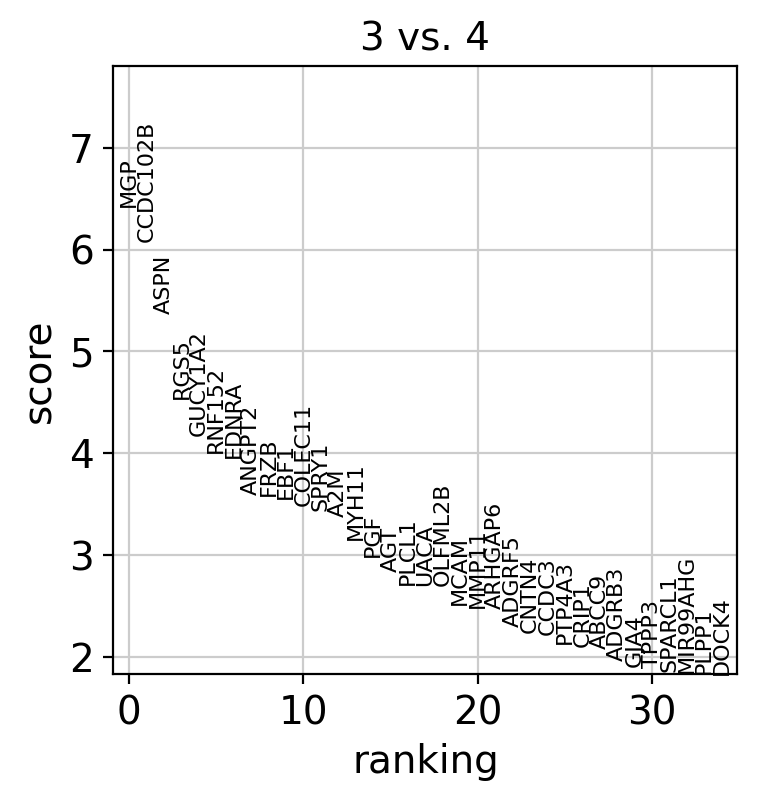

In [40]:
## see that Cluster 3 has more TAGLN, ACTA2 than cluster 9
### Compare DE genes
# DE genes between Therapy treated vs None for C1QC TAMs
sc.tl.rank_genes_groups(
    adata,
    groupby="leiden_scVI",
    groups=["3"],
    reference="4",
    method="wilcoxon",
    layer="log1p",
    pts=True,
    corr_method="benjamini-hochberg",
    key_added="rank_genes_wilcoxon_3",
    use_raw=False,
)

sc.pl.rank_genes_groups(adata, groups=["3"], n_genes=35, key="rank_genes_wilcoxon_3")

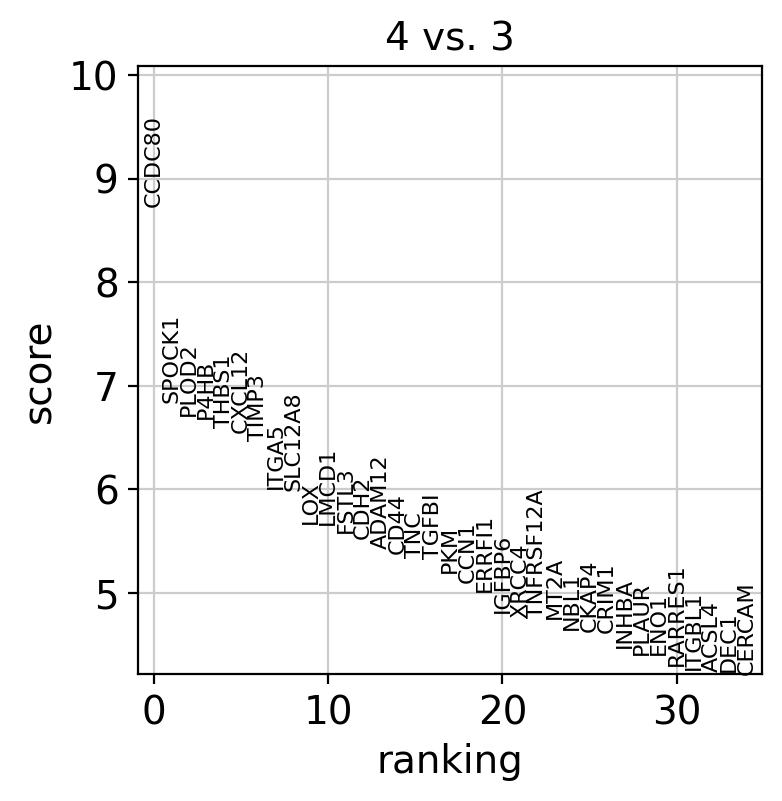

In [41]:
## see that Cluster 3 has more TAGLN, ACTA2 than cluster 9
### Compare DE genes
# DE genes between Therapy treated vs None for C1QC TAMs
sc.tl.rank_genes_groups(
    adata,
    groupby="leiden_scVI",
    groups=["4"],
    reference="3",
    method="wilcoxon",
    layer="log1p",
    pts=True,
    corr_method="benjamini-hochberg",
    key_added="rank_genes_wilcoxon_4",
    use_raw=False,
)

sc.pl.rank_genes_groups(adata, groups=["4"], n_genes=35, key="rank_genes_wilcoxon_4")

### Annotation

Activation of collagen producing myofibroblasts is critical for the pathogenesis of liver fibrosis
HSC activated become myofibroblast. Activated HSCs (aHSCs) are the major source of myofibroblasts in chronic toxic liver injury (HBV, HCV infection, ALD, and NAFLD).  They also upregulate production of matrix metalloproteinases MMPs, especially MMP13.

Myofibroblasts combine the matrix-producing functions of fibroblasts and the contractile properties of smooth muscle cells.

From **A single cell atlas of the human liver tumor microenvironment**
Hepatic stellate cells, marked by the retinol binding protein 1 (RBP1), and vascular smooth muscle cells, marked by Myosin-11 (MYH11) (Ramachandran et al, 2019), were abundant in the non-malignant liver sites (Fig 3A, Appendix Fig S1C). Mesenchymal cells in the malignant liver sites included two clusters. Cancer-associated fibroblasts (CAFs), expressing extracellular matrix (ECM) genes such as COL1A1, LUM, and BGN, formed the larger cluster. A second cluster included cells expressing classic markers of pericytes, periendothelial mesenchymal cells with important roles in regulating vascular integrity (Armulik et al, 2011). These markers included RGS5 and CSPG4, encoding the neuron-glial antigen 2 protein (NG2) (Armulik et al, 2011). We found that some previously suggested markers of pericytes, such as DES (Nehls et al, 1992) and ANPEP (Kumar et al, 2017), were not specifically expressed in pericytes in the malignant human liver context (Dataset EV3). Importantly, pericytes were almost absent from the non-malignant sites (Appendix Fig S1C). 

In [4]:
adata = sc.read_h5ad(
    DIR2SAVE.joinpath(
        "Multiome_Che_Wu_CRC_LM_integrated_scvi_hvg_Stromal_clustering.h5ad"
    )
)

In [5]:
old_to_new = {
    "0": "ECM CAF",
    "1": "SMC",
    "2": "ECM CAF",
    "3": "ECM CAF",
    "4": "Myofibroblast",  # HSC into myofibroblast, because those are activated HSC right? With actin and taglin upregulated?
    "5": "Stromal unknown",
    "6": "ECM CAF",
    "7": "HSP",
    "8": "C3 iCAF",
    "9": "T cell doublet",
    "10": "Pericyte",
    "11": "Myofibroblast",  # was annotated as such when we did the individual analysis
}
# ECM CAF:  ECM CAFs (mCAFs), expressing low levels of ACTA2 but high levels of ECM-associated genes
# including various collagens, MMP11, MMP2, MMP14, PDGFRA, LAMA2, COL3A1, COL1A2, LUM, DCN and VCAN

In [6]:
adata.obs["Annotation_scVI_detailed"] = (
    adata.obs["leiden_scVI"].map(old_to_new).astype("category")
)

**ANNOTATION JUSTIFICATION**

* 0: ECM CAF because CCN2, CCN1, COL12A1, COL18A1, GREM1, SEPINE1, VCAN, COL5A2, LAMA2, FN1, MYH10, COL4A1, MYOF, ITGA1
* 1: SMC
* 2: ECM CAF because LAMA2, COL8A1, ITGA1, VCAN, COL16A1, COL3A1, COL4A1, FN1, POSTN, COL1A2
* 3: ECM CAF because COL18A1, COL1A1, SPARC, COL3A1, LAMA4, COL4A2
* 4: Myofibroblast ACTA2, TAGLN, COL4A1, COL1A1, COL1A2, COL1A3, POSTN, MYH010, TPM1, TPM2
* 5: Stromal unknown
* 6: ECM CAF (lots of MMPs): MMP2, MMP14, MMP11, GREM1, SERPINE1, POSTN, COL3A1, LUM, PLAU, COL1A2, VCAN, COL1A2, COL6A3, ECM1
* 7: HSP because a lot of HSP
* 8: C3 iCAF because C3 C7, icaf signature score high
* 9: T cell doublet lots of T cell markers
* 10: Pericyte because pericyte markers ABCC9, RGS5
* 11: Myofibroo

### Colours

In [8]:
adata.obs["Annotation_scVI_detailed"].cat.categories.tolist()

['C3 iCAF',
 'ECM CAF',
 'HSP',
 'Myofibroblast',
 'Pericyte',
 'SMC',
 'Stromal unknown',
 'T cell doublet']

In [10]:
adata.uns["Annotation_scVI_detailed_colors"] = [
    "#41ab5d",
    "#f0027f",
    "#969696",
    "#fc8d59",
    "#addd8e",
    "#feb24c",
    "#386cb0",
    "#f768a1",
]

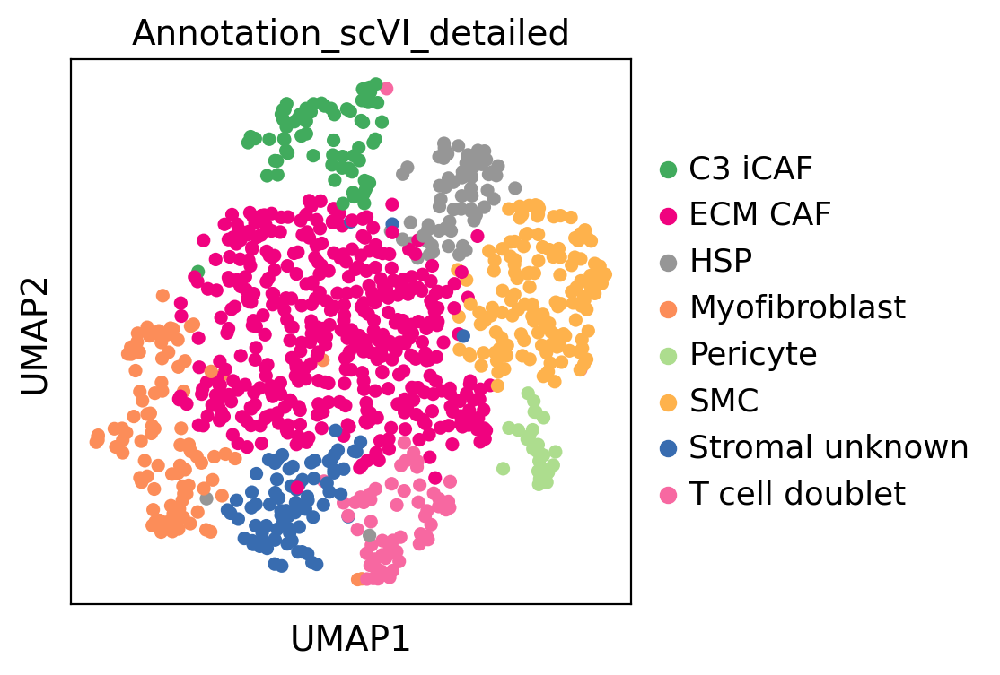

In [11]:
sc.pl.umap(
    adata,
    color="Annotation_scVI_detailed",
    show=True,
    legend_loc="right margin",
    save="annotations.pdf",
)

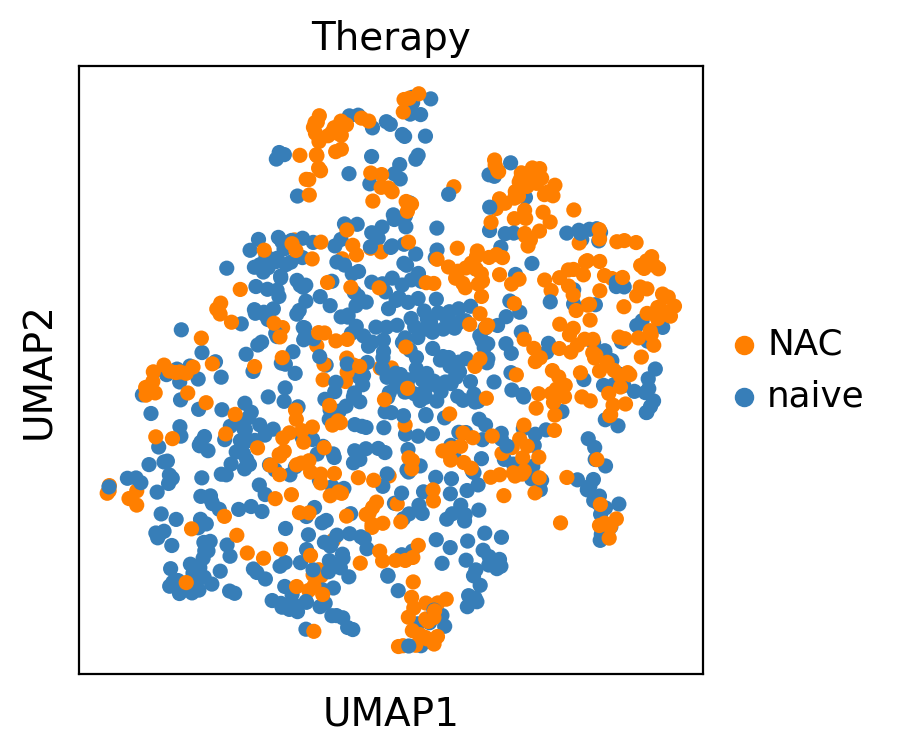

In [12]:
sc.pl.umap(
    adata, color="Therapy", show=True, legend_loc="right margin", save="therapy.pdf"
)

### write to file

In [13]:
# write to file
adata.write(
    DIR2SAVE.joinpath(
        "Multiome_Che_Wu_CRC_LM_integrated_scvi_hvg_Stromal_clustering.h5ad"
    )
)

# write csv of annotations
adata.obs["Annotation_scVI_detailed"].to_csv(
    DIR2SAVE.joinpath(
        "Multiome_Che_Wu_CRC_LM_integrated_scvi_hvg_Stromal_clustering_annotations.txt"
    ),
    sep="\t",
    index=True,
    header=True,
)

In [14]:
adata.obs["Annotation_scVI_detailed"].value_counts()

ECM CAF            441
SMC                143
Myofibroblast      101
Stromal unknown     80
C3 iCAF             71
HSP                 71
T cell doublet      65
Pericyte            30
Name: Annotation_scVI_detailed, dtype: int64

In [15]:
adata.obs.groupby(["Annotation_scVI_detailed", "cell_source"]).size()

Annotation_scVI_detailed  cell_source
C3 iCAF                   BCI-Nuclei      44
                          Che-Cells       27
ECM CAF                   BCI-Nuclei     370
                          Che-Cells       71
HSP                       BCI-Nuclei      12
                          Che-Cells       59
Myofibroblast             BCI-Nuclei      75
                          Che-Cells       26
Pericyte                  BCI-Nuclei      27
                          Che-Cells        3
SMC                       BCI-Nuclei      33
                          Che-Cells      110
Stromal unknown           BCI-Nuclei      67
                          Che-Cells       13
T cell doublet            BCI-Nuclei      40
                          Che-Cells       25
dtype: int64

### =====
## Note
stromal unknown which is cluster 5 has VEGFA, HIF1A, COL6A3 but high decontx score so is contamination